<a href="https://colab.research.google.com/github/peterhuba/clustering-twitter-users/blob/master/twitter_cluster_gmm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Recently Twitter has released a dataset consisting of the tweets of suspended accounts that are
believed to be connected to the Russian Internet Research Agency or originating from Iran and potentially
involved in a state-backed information operations aiming to influence the U.S. presidential election of
2016. 

In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

import csv
with open('/content/gdrive/My Drive/IRAhandle_tweets_1.csv', 'r') as f:
    reader = csv.reader(f)
    tweets = list(reader)

list(tweets[0])

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


['external_author_id',
 'author',
 'content',
 'region',
 'language',
 'publish_date',
 'harvested_date',
 'following',
 'followers',
 'updates',
 'post_type',
 'account_type',
 'new_june_2018',
 'retweet',
 'account_category']

The aim is to identify the topic which seem to be discussed by the potentially malevolent entities. The
software should provide a visual way of exploring the dataset, observing eventual similarities or patterns
among tweets or accounts.

In [0]:
tweets = [t for t in tweets if t[4]=='English']
list(tweets[1:5])

[['9.06000000000e+17',
  '10_GOP',
  'Marshawn Lynch arrives to game in anti-Trump shirt. Judging by his sagging pants the shirt should say Lynch vs. belt https://t.co/mLH1i30LZZ',
  'Unknown',
  'English',
  '10/1/2017 22:43',
  '10/1/2017 22:43',
  '1054',
  '9637',
  '254',
  '',
  'Right',
  '0',
  '0',
  'RightTroll'],
 ['9.06000000000e+17',
  '10_GOP',
  'Daughter of fallen Navy Sailor delivers powerful monologue on anthem protests, burns her NFL packers gear.  #BoycottNFL https://t.co/qDlFBGMeag',
  'Unknown',
  'English',
  '10/1/2017 22:50',
  '10/1/2017 22:51',
  '1054',
  '9637',
  '255',
  'RETWEET',
  'Right',
  '0',
  '1',
  'RightTroll'],
 ['9.06000000000e+17',
  '10_GOP',
  'JUST IN: President Trump dedicates Presidents Cup golf tournament trophy to the people of Florida, Texas and Puerto Rico. https://t.co/z9wVa4djAE',
  'Unknown',
  'English',
  '10/1/2017 23:52',
  '10/1/2017 23:52',
  '1062',
  '9642',
  '256',
  '',
  'Right',
  '0',
  '0',
  'RightTroll'],
 ['9.06

Currently there are available many versions of the dataset mentioned above, including some which are
labeled by some entity other than Twitter. For now, I focused on the information available on the original
dataset to meet the requirement of future extendibility as future data will not be available labeled if it is
obtained in real time, for example. 

The amount of data provides many possibilities of extracting information, for instance observing the
network of followers among the accounts, reactions and the temporal aspect of retweets, which could
add more insight into potentially coordinated activities. For now, I am going to focus on analyzing the
tweet text only.

In [0]:
len(tweets)

291571

In [0]:
!pip install hdbscan
!pip install stop_words
!pip install tweet_parser
!pip install searchtweets 
!pip install MulticoreTSNE

    100% |████████████████████████████████| 4.0MB 6.6MB/s 
  Installing build dependencies ... - \ | / - \ | / done
  Running setup.py bdist_wheel for hdbscan ... - \ | / - \ | / - \ | / - \ | / - \ | / - done
  Stored in directory: /root/.cache/pip/wheels/80/6c/bb/80343f12bfe907f9475ae274a59677bec4525104455a6c2554
Successfully built hdbscan
  Running setup.py bdist_wheel for stop-words ... - done
  Stored in directory: /root/.cache/pip/wheels/75/37/6a/2b295e03bd07290f0da95c3adb9a74ba95fbc333aa8b0c7c78
Successfully built stop-words
  Running setup.py bdist_wheel for tweet-parser ... - done
  Stored in directory: /root/.cache/pip/wheels/2a/92/c7/d5d2039011d9a8afe012c08477ddb4c230e42c7d5620bb14a0
Successfully built tweet-parser
  Running setup.py bdist_wheel for MulticoreTSNE ... - \ | / - \ | / - \ done
  Stored in directory: /root/.cache/pip/wheels/27/59/53/3b52ee63add3692254c30d687fa4dff4d128d0557861fb02

In [0]:
from collections import Counter
import itertools as it
import json
import logging
import os
import re
import string
import sys

from bokeh.plotting import figure, ColumnDataSource, show, output_notebook; output_notebook()
from bokeh.models import HoverTool
from bokeh.palettes import brewer, Viridis256
import matplotlib.pyplot as plt
from nltk.util import everygrams
from nltk.tokenize.casual import TweetTokenizer
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.externals import joblib
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import silhouette_score
from sklearn.decomposition import TruncatedSVD
from stop_words import get_stop_words
from tweet_parser.tweet import Tweet
from searchtweets import load_credentials, gen_rule_payload, collect_results
from MulticoreTSNE import MulticoreTSNE as TSNE
import yaml

pd.set_option('display.max_colwidth', 150)

seed = 42

plt.style.use("bmh")
%matplotlib inline

Loading BokehJS ...

In [0]:
def tweets_to_df(tweets):
    # convert raw data from the dataset to pandas data frames
    tweet_df = pd.DataFrame({'text': [t[2] for t in tweets],
                             'uid': [t[1] for t in tweets],}
                           )
    return tweet_df

In [0]:
tweet_df = tweets_to_df(tweets)
tweet_df.head()

,text,uid
0,"""We have a sitting Democrat US Senator on trial for corruption and you've barely heard a peep from the mainstream media."" ~ @nedryun https://t.co/...",10_GOP
1,Marshawn Lynch arrives to game in anti-Trump shirt. Judging by his sagging pants the shirt should say Lynch vs. belt https://t.co/mLH1i30LZZ,10_GOP
2,"Daughter of fallen Navy Sailor delivers powerful monologue on anthem protests, burns her NFL packers gear. #BoycottNFL https://t.co/qDlFBGMeag",10_GOP
3,"JUST IN: President Trump dedicates Presidents Cup golf tournament trophy to the people of Florida, Texas and Puerto Rico. https://t.co/z9wVa4djAE",10_GOP
4,"19,000 RESPECTING our National Anthem! #StandForOurAnthem🇺🇸 https://t.co/czutyGaMQV",10_GOP


In [0]:
def get_all_tokens(tweet_list):
    # split tweets to words and concatenate all of them
    all_text = ' '.join((t[2] for t in tweets))
    
    tokens = (TweetTokenizer(preserve_case=False,
                            reduce_len=True,
                            strip_handles=False)
              .tokenize(all_text))
    
    # remove symbols
    tokens = [tok for tok in tokens if not tok in string.punctuation]
    return tokens

In [0]:
tokens = get_all_tokens(tweets)

In [0]:
# observe repeating groups as data inspection
top_grams = Counter(everygrams(tokens, min_len=3, max_len=4))
top_grams.most_common(25)

[(('�', '�', '�'), 2906),
 (('trump', '’', 's'), 1971),
 (('our', 'patriot', 'army'), 1636),
 (('enlist', 'in', 'the'), 1434),
 (('patriot', 'army', 'at'), 1419),
 (('our', 'patriot', 'army', 'at'), 1416),
 (('the', '#usfa', 'at'), 1316),
 (('enlist', 'in', 'our'), 1272),
 (('in', 'the', '#usfa'), 1244),
 (('rt', 'rt_america', 'to'), 1233),
 (('rt_america', 'to', '#maga'), 1233),
 (('rt', 'rt_america', 'to', '#maga'), 1233),
 (('retweet', 'rt', 'rt_america'), 1221),
 (('retweet', 'rt', 'rt_america', 'to'), 1221),
 (('in', 'the', '#usfa', 'at'), 1220),
 (('it', '’', 's'), 1211),
 (('enlist', 'in', 'the', '#usfa'), 1208),
 (('in', 'our', 'patriot'), 1194),
 (('enlist', 'in', 'our', 'patriot'), 1187),
 (('in', 'our', 'patriot', 'army'), 1179),
 (('enlist', 'with', 'us'), 945),
 (('army', 'at', '…'), 944),
 (('with', 'us', 'at'), 933),
 (('enlist', 'with', 'us', 'at'), 912),
 (('to', 'lose', 'weight'), 861)]

In [0]:
mask = tweet_df['text'].str.lower().str.contains("black")
tweet_df[mask][['text']].head(10)

,text
94,Wow... Black Lives Matter protesters shut down the ACLU's campus free speech event because 'Liberalism is white supremacy' https://t.co/fmMiqIKrTF
307,We’ve gone from “Trump is Putin's puppet” to “some Russians bought Facebook ads for Black Lives Matter.” Amazing.
336,".@RedPillBlack: ""You know how liberals are - they are the most accepting people in the entire world, unless you think differently."" https://t.co/J..."
414,It’s reasonable to ban firearms sales in #black areas #NoGunsForCriminals https://t.co/48st3RcXpu
461,Degli hacker hanno diffuso la nuova stagione di “Orange is the new Black” https://t.co/LJqU44VqjV
472,"Blackout Gardaland: Ad,causa sbalzo Enel https://t.co/9H1nn3XyS5"
583,#blacklivesmatter #blm #equality #equalrights https://t.co/iKjXVxTmJz
586,Black Students force the university to divest $25 Million in private prisons https://t.co/1iCvXy8UzC #blacktwitter https://t.co/CXL7DSzpBa
591,At last! NYPD cop In Eric Garner's Death Faces Departmental Charges #blacklivesmatter #policestate #policebrutality https://t.co/SRRUSjL96U
597,"On this day in 1966, Johnson appoints first African-American cabinet member - Robert C. Weaver #blacktwitter https://t.co/R1pd0o76sn"


In [0]:
unique_user_cnt = len(set(tweet_df['uid']))
unique_user_cnt

354

In [0]:
def replace_urls(in_string, replacement=None):
    # replace url's with other strings, empty string in the current use case
    replacement = '' if replacement is None else replacement
    pattern = re.compile('(https?://)?(\w*[.]\w+)+([/?=&]+\w+)*')
    return re.sub(pattern, replacement, in_string)

In [0]:
def tweet_tokenizer(in_string):
    # tokenizer to be passed to tfidf
    tokenizer = TweetTokenizer(preserve_case=False,
                               reduce_len=True,
                               strip_handles=False)
    tokens = tokenizer.tokenize(in_string)
    return tokens

In [0]:
Counter([t[4] for t in tweets]).most_common(10)

[('English', 291571)]

In [0]:
languages = ['english']
my_stopwords = list(set(it.chain.from_iterable((get_stop_words(lang)
                                                for lang in languages))))

In [0]:
def generate_punctuation_stopwords(max_length=3):
    def punct_maker(length):
        return ((''.join(x) for x in it.product(string.punctuation,
                                                repeat=length)))
    words = it.chain.from_iterable((punct_maker(length)
                                    for length in range(max_length+1)))
    return list(words)

In [0]:
my_stopwords = list(it.chain(my_stopwords, generate_punctuation_stopwords(max_length=3)))

print('stopwords and punctuation words count: {}'.format(len(my_stopwords)))

stopwords and punctuation words count: 33999


After tokenization removing common stopwords and punctuation, the corpus can be processed using
term frequency – inverse document frequency method. This would provide us a view of the terms, topics
most frequently appearing among the tweets.

We are going to treat the users as observations and their tweets are going to describe them. Therefore,
we need to create a map where the users are keys and all the tweets of the user are the values. The value
of this map is going to be passed to the tf-idf vectorizer.
The maximum of features to be processed by the vectorizer can be passed as a parameter. If the
parameter is set, only a certain amount of the most relevant features will be taken into account. According
to a paper by Martin Zinkevich (Rules of Machine Learning: Best Practices for ML Engineering) a good practice is to keep the ratio of observations to features to about
1:100. For now, a 1:10 ratio will be used, since only a subset of the originally huge dataset will be
processed as a demonstration.


In [0]:
vec = TfidfVectorizer(preprocessor=replace_urls,
                      tokenizer=tweet_tokenizer,
                      stop_words=my_stopwords,
                      max_features=unique_user_cnt//10, # keeping the number of features lower than the number of observations
                     )

In [0]:
# create one map entry per user
users_tweets_map = dict()
for t in tweets:
    if t[1] in users_tweets_map:
        users_tweets_map[t[1]] += ' ' + t[2]
        
    else:
        users_tweets_map[t[1]] = t[2]

        


In [0]:
print(users_tweets_map['10_GOP'])
print(tweets[0])

"We have a sitting Democrat US Senator on trial for corruption and you've barely heard a peep from the mainstream media." ~ @nedryun https://t.co/gh6g0D1oiC Marshawn Lynch arrives to game in anti-Trump shirt. Judging by his sagging pants the shirt should say Lynch vs. belt https://t.co/mLH1i30LZZ Daughter of fallen Navy Sailor delivers powerful monologue on anthem protests, burns her NFL packers gear.  #BoycottNFL https://t.co/qDlFBGMeag JUST IN: President Trump dedicates Presidents Cup golf tournament trophy to the people of Florida, Texas and Puerto Rico. https://t.co/z9wVa4djAE 19,000 RESPECTING our National Anthem! #StandForOurAnthem🇺🇸 https://t.co/czutyGaMQV Dan Bongino: "Nobody trolls liberals better than Donald Trump." Exactly!  https://t.co/AigV93aC8J 🐝🐝🐝 https://t.co/MorL3AQW0z '@SenatorMenendez @CarmenYulinCruz Doesn't matter that CNN doesn't report on your crimes. This won't change the fact that you're going down.' As much as I hate promoting CNN article, here they are admit

In [0]:
texts = users_tweets_map.values()
list(texts)[0]

'"We have a sitting Democrat US Senator on trial for corruption and you\'ve barely heard a peep from the mainstream media." ~ @nedryun https://t.co/gh6g0D1oiC Marshawn Lynch arrives to game in anti-Trump shirt. Judging by his sagging pants the shirt should say Lynch vs. belt https://t.co/mLH1i30LZZ Daughter of fallen Navy Sailor delivers powerful monologue on anthem protests, burns her NFL packers gear.  #BoycottNFL https://t.co/qDlFBGMeag JUST IN: President Trump dedicates Presidents Cup golf tournament trophy to the people of Florida, Texas and Puerto Rico. https://t.co/z9wVa4djAE 19,000 RESPECTING our National Anthem! #StandForOurAnthem🇺🇸 https://t.co/czutyGaMQV Dan Bongino: "Nobody trolls liberals better than Donald Trump." Exactly!  https://t.co/AigV93aC8J 🐝🐝🐝 https://t.co/MorL3AQW0z \'@SenatorMenendez @CarmenYulinCruz Doesn\'t matter that CNN doesn\'t report on your crimes. This won\'t change the fact that you\'re going down.\' As much as I hate promoting CNN article, here they a

In [0]:
# calculate the data matrix
tweet_matrix = vec.fit_transform(list(texts))

tweet_matrix

<354x35 sparse matrix of type '<class 'numpy.float64'>'
	with 5726 stored elements in Compressed Sparse Row format>

This matrix of tf-idf features is going to be passed to the clusterizer. Similarly to k-means, GMM also
requires the number of clusters as a parameter. The elbow method is going to be applied to determine
an optimal number of clusters. The metric of silhouette score will be applied to determine the optimal k
number of clusters to be used, from an initially set range. Iteratively increasing number will be passed as
number of clusters parameter to the GMM class and the trained model will be evaluated with the metric
mentioned above.

The silhouette coefficients provide a measure of how close each point in one cluster is to points in the neighboring clusters.

In [0]:
from sklearn.mixture import GaussianMixture

def evaluate_cluster_sizes(ks, data_matrix):
    sil_scores = []
    inertias = []

    for k in ks:
        logging.warning('fitting model for {} clusters'.format(k))
        model = GaussianMixture(n_components=k, random_state=seed)
        model.fit(data_matrix.toarray())
        labels = model.predict(data_matrix.toarray())
        sil_scores.append(silhouette_score(data_matrix, labels))
        inertias.append(0)

    plt.plot(ks, sil_scores, 'o--')
    plt.ylabel('silhouette score')
    plt.xlabel('k');

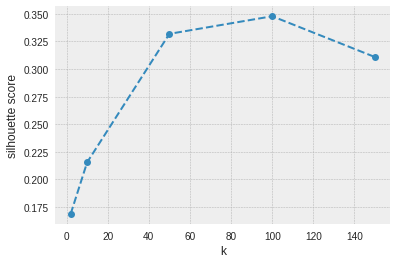

In [0]:
# cluster sizes to analyze
ks = [2, 10, 50, 100, 150]
evaluate_cluster_sizes(ks, tweet_matrix)

In [0]:
best_k = 50

gmm_model = GaussianMixture(n_components=best_k, random_state=seed)
gmm_model.fit(tweet_matrix.toarray())

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
        means_init=None, n_components=50, n_init=1, precisions_init=None,
        random_state=42, reg_covar=1e-06, tol=0.001, verbose=0,
        verbose_interval=10, warm_start=False, weights_init=None)

In [0]:
gmm_labels = gmm_model.predict(tweet_matrix.toarray())

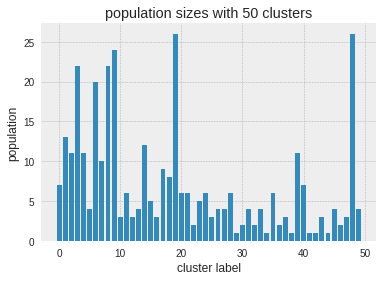

In [0]:
plt.bar(range(len(set(gmm_labels))), np.bincount(gmm_labels))

plt.ylabel('population')
plt.xlabel('cluster label')
plt.title('population sizes with {} clusters'.format(best_k));

In [0]:
def cluster_sample(orig_text, idx, gmm_labels, preview=15):
    # get a peek into a cluster's contents
    for i,idx in enumerate(np.where(gmm_labels == idx)[0]):
        print(orig_text[idx].replace('\n',' '))
        print()
        if i > preview:
            print('( # preview end # )')
            break

In [0]:
interest_idx = 1
cluster_sample(list(texts), interest_idx, gmm_labels)

Given the high dimensionality of the data, a method to reduce the number of dimensions to 2 or 3 is
needed. One such method is t-distributed stochastic neighbor embedding. In the model similar objects are modeled as nearby points and
dissimilar objects are modeled as distant points, with high probability.


In [0]:
def fit_tsne(tweet_matrix):
    logging.warning("Fitting TSNE")
    tsne = TSNE(n_components=2,
                n_jobs=-1,
                random_state=seed)
    tweet_matrix_2d = tsne.fit_transform(tweet_matrix.todense())
    return tweet_matrix_2d

In [0]:
tweet_matrix_2d = fit_tsne(tweet_matrix)

In [0]:
def get_plottable_df(users, texts, two_d_coords, labels):
    # create data frame to be plotted
    num_labels = len(set(labels))
    colors = sns.color_palette('hls', num_labels).as_hex()
    color_lookup = {v:k for k,v in zip(colors, set(labels))}
    # combine data into a single df
    df = pd.DataFrame({'uid': users,
                       'text': texts,
                       'label': labels,
                       'x_val': two_d_coords[:,0],
                       'y_val': two_d_coords[:,1],
                      })
    # convert labels to colors
    df['color'] = list(map(lambda x: color_lookup[x], labels))
    return df

In [0]:
gmm_plottable_tweets = get_plottable_df(list(users_tweets_map.keys()), list(texts), tweet_matrix_2d, gmm_labels)
gmm_plottable_tweets.head()

,label,text,uid,x_val,y_val,color
0,32,"""We have a sitting Democrat US Senator on trial for corruption and you've barely heard a peep from the mainstream media."" ~ @nedryun https://t.co/...",10_GOP,-3.758595,-8.314539,#5764db
1,47,#FoodPoisoning is not a joke! #Walmart #KochFarms https://t.co/o4i3tFAEgv https://t.co/pv5lmkdWgE Thanks God that #turkey i ate few days ago was g...,1D_NICOLE_,3.507803,3.025765,#db577e
2,20,Why is someone even against the #petition? I'll watch you bleeding when some thug shoots your ass off #NoGunsForCriminals It’s reasonable to ban f...,1ERIK_LEE,0.677234,-2.281268,#57db94
3,27,Come vedere Juventus-Milan in streaming o in tv https://t.co/NHlb4OgXXY #SerieA in campo #JuventusMilan LIVE e FOTO https://t.co/zR8rrsmSPL #Priva...,1LORENAFAVA1,0.030898,-11.178190,#57b4db
4,37,'@HalfOnionInABag Follow the other half an onion! Mage America Great Again1' '@HalfOnionInABag Follow another half of the onion. Reveal it's dark ...,2NDHALFONION,7.435483,-0.119374,#9957db


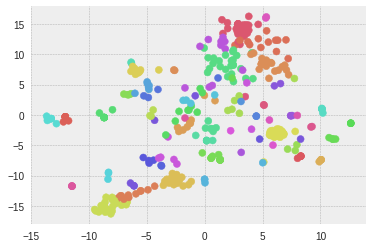

In [0]:
plt.scatter(gmm_plottable_tweets['x_val'].tolist(), gmm_plottable_tweets['y_val'].tolist(), c=gmm_plottable_tweets['color'].tolist())

In [0]:
def plot_tsne(df, title='t-SNE plot'):
    # add data frame as ColumnDataSource for Bokeh visualization library
    plot_data = ColumnDataSource(df)
    # configure the chart
    tsne_plot = figure(title=title, plot_width=800, plot_height=700, tools=('pan, box_zoom, reset'))
    # add a hover tool to display words on roll-over
    tsne_plot.add_tools(
        HoverTool(tooltips = """<div style="width: 400px;">(@label) @text</div>""")
    )
    # draw the words as circles on the plot
    tsne_plot.circle('x_val', 'y_val',
                     source=plot_data,
                     color='color',
                     line_alpha=0.8,
                     fill_alpha=0.6,
                     size=7,
                     hover_line_color='black')
    # configure visual elements of the plot
    tsne_plot.title.text_font_size = '12pt'
    tsne_plot.xaxis.visible = False
    tsne_plot.yaxis.visible = False
    tsne_plot.grid.grid_line_color = None
    tsne_plot.outline_line_color = None
    return tsne_plot

In [0]:
output_notebook()
show(plot_tsne(gmm_plottable_tweets, 'GMM-clustered users based on tweets'))

Loading BokehJS ...